### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?

In [102]:
import pandas as pd
import numpy as np
from sklearn import model_selection
import matplotlib.pyplot as plt
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import Normalizer

In [103]:
df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


# x --> Income
# y --> Price

In [104]:
seed = 42
estandarizacion = False

x = np.array(df['Avg. Area Income']).reshape(-1, 1)
y = np.array(df['Price'])
print('x:', x.shape)
print('y:', y.shape)

if estandarizacion == True:
    st_x = StandardScaler()
    x = st_x.fit_transform(x)
    st_y = StandardScaler()
    y = y.reshape(-1, 1)
    y = st_y.fit_transform(y)

x_train, x_test, y_train, y_test = model_selection.train_test_split(x, y, test_size=0.2, random_state = seed)

x: (5000, 1)
y: (5000,)


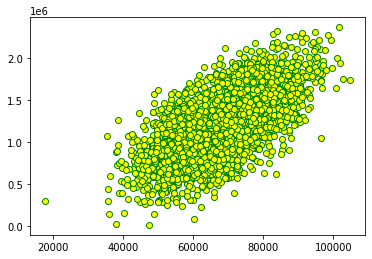

In [105]:
plt.scatter(x_train, y_train, color='yellow', edgecolors='green')

Score TRAIN (R2) - Degree =  2 :  0.413 

Score TEST (R2) - Degree =  2 :  0.397 



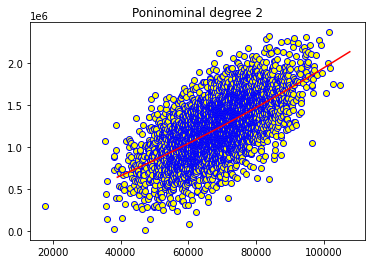



Score TRAIN (R2) - Degree =  3 :  0.413 

Score TEST (R2) - Degree =  3 :  0.397 



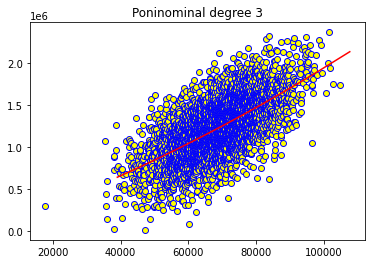



Score TRAIN (R2) - Degree =  4 :  0.413 

Score TEST (R2) - Degree =  4 :  0.397 



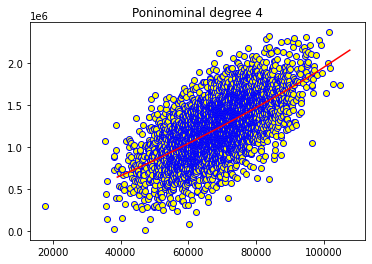



Score TRAIN (R2) - Degree =  5 :  0.413 

Score TEST (R2) - Degree =  5 :  0.397 



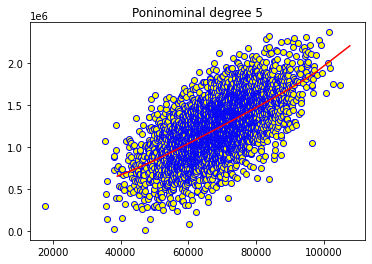



Score TRAIN (R2) - Degree =  6 :  0.412 

Score TEST (R2) - Degree =  6 :  0.397 



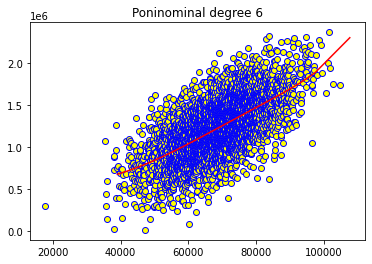



Score TRAIN (R2) - Degree =  7 :  0.412 

Score TEST (R2) - Degree =  7 :  0.397 



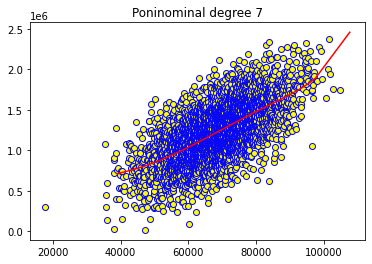



Score TRAIN (R2) - Degree =  8 :  0.41 

Score TEST (R2) - Degree =  8 :  0.394 



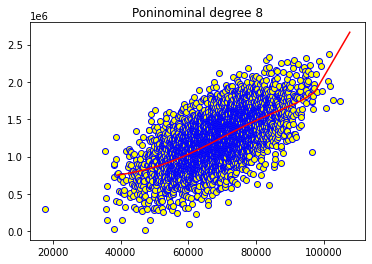



Score TRAIN (R2) - Degree =  9 :  0.407 

Score TEST (R2) - Degree =  9 :  0.388 



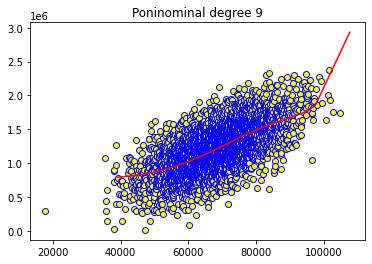



Score TRAIN (R2) - Degree =  10 :  0.404 

Score TEST (R2) - Degree =  10 :  0.379 



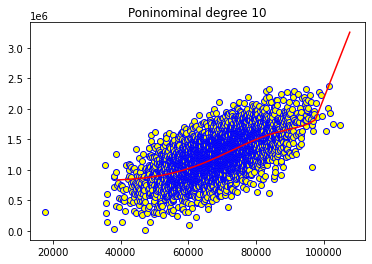



Scores TRAIN:  {'2': 0.413, '3': 0.413, '4': 0.413, '5': 0.413, '6': 0.412, '7': 0.412, '8': 0.41, '9': 0.407, '10': 0.404}
Scores TEST:  {'2': 0.397, '3': 0.397, '4': 0.397, '5': 0.397, '6': 0.397, '7': 0.397, '8': 0.394, '9': 0.388, '10': 0.379}


In [118]:
degree_min = 2
degree_max = 10
scores_train_degree = {}
scores_test_degree = {}
for degree in range(degree_min, degree_max + 1):
    polinomial_model = PolynomialFeatures(degree = degree)
    x_train_poly = polinomial_model.fit_transform(x_train, y_train)

# Entrenar la LinearRegression con la salida del fit_transform (x_train_poly, y_train)
    linreg_model = LinearRegression()
    linreg_model.fit(x_train_poly, y_train)

# Predicción de "y" con "x_poly"
    y_train_pred = linreg_model.predict(x_train_poly)
    #print('y_pred:', y_pred)
    r2_score(y_train, y_train_pred)
    print('Score TRAIN (R2) - Degree = ', degree, ': ', round(r2_score(y_train, y_train_pred),3), '\n')
    scores_train_degree[str(degree)] = round(r2_score(y_train, y_train_pred),3)

# AHORA PARA TEST --> Nótese que, como el modelo polinómico ya está entrenado... No hace falta poner y_train.
    x_test_poly = polinomial_model.fit_transform(x_test) 
    y_test_pred = linreg_model.predict(x_test_poly)
    print('Score TEST (R2) - Degree = ', degree, ': ', round(r2_score(y_test, y_test_pred),3), '\n')
    scores_test_degree[str(degree)] = round(r2_score(y_test, y_test_pred),3)
    


    x_train_to_show, y_train_to_show = zip(*sorted(zip(x_train, y_train)))
    plt.scatter(x_train_to_show, y_train_to_show, color='yellow', edgecolors='blue')
    x_test_to_show, y_test_pred = zip(*sorted(zip(x_test, y_test_pred)))
    plt.plot(x_test_to_show, y_test_pred, color='red')
    #plt.scatter(x_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()
    print('\n===========================================================\n')
print('Scores TRAIN: ', scores_train_degree)
print('Scores TEST: ', scores_test_degree)

## No se observan cambios considerables de score a partir de grado 2.

---

# x --> Age
# y --> Price

In [89]:
seed = 42
estandarizacion = True

x = np.array(df['Avg. Area House Age']).reshape(-1, 1)
y = np.array(df['Price'])
print('x:', x.shape)
print('y:', y.shape)

if estandarizacion == True:
    st_x = StandardScaler()
    x = st_x.fit_transform(x)
    st_y = StandardScaler()
    y = y.reshape(-1, 1)
    y = st_y.fit_transform(y)

x_train, x_test, y_train, y_test = model_selection.train_test_split(x, y, test_size=0.2, random_state = seed)

x: (5000, 1)
y: (5000,)


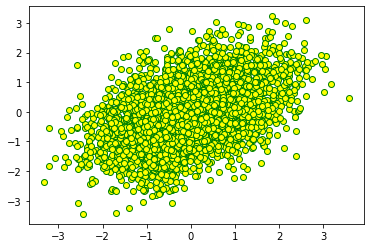

In [90]:
plt.scatter(x_train, y_train, color='yellow', edgecolors='green')

Score TRAIN (R2) - Degree =  2 :  0.202 

Score TEST (R2) - Degree =  2 :  0.216 



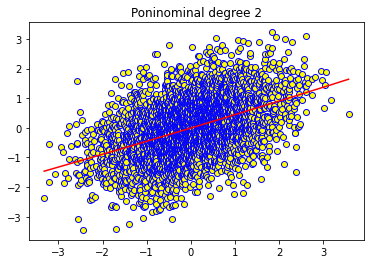



Score TRAIN (R2) - Degree =  3 :  0.202 

Score TEST (R2) - Degree =  3 :  0.216 



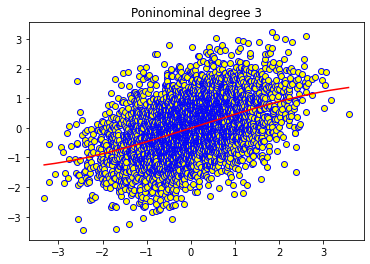



Score TRAIN (R2) - Degree =  4 :  0.202 

Score TEST (R2) - Degree =  4 :  0.216 



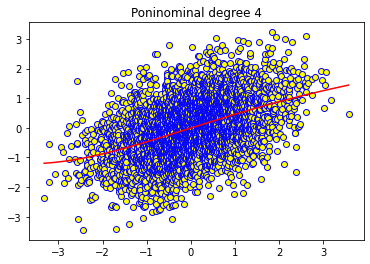



Score TRAIN (R2) - Degree =  5 :  0.202 

Score TEST (R2) - Degree =  5 :  0.217 



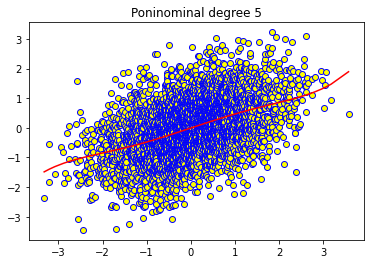



Score TRAIN (R2) - Degree =  6 :  0.203 

Score TEST (R2) - Degree =  6 :  0.218 



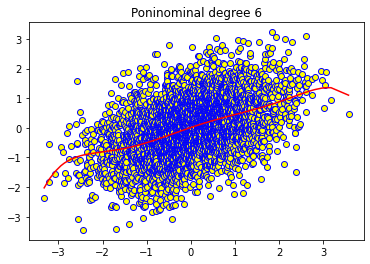



Score TRAIN (R2) - Degree =  7 :  0.204 

Score TEST (R2) - Degree =  7 :  0.217 



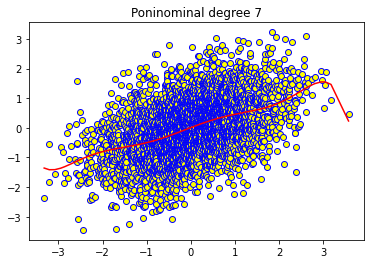



Score TRAIN (R2) - Degree =  8 :  0.204 

Score TEST (R2) - Degree =  8 :  0.217 



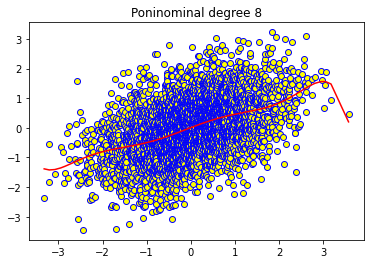



Score TRAIN (R2) - Degree =  9 :  0.205 

Score TEST (R2) - Degree =  9 :  0.217 



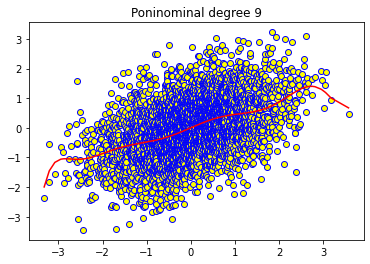



Score TRAIN (R2) - Degree =  10 :  0.206 

Score TEST (R2) - Degree =  10 :  0.215 



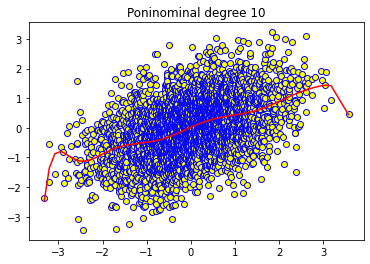



Scores TRAIN:  {'2': 0.202, '3': 0.202, '4': 0.202, '5': 0.202, '6': 0.203, '7': 0.204, '8': 0.204, '9': 0.205, '10': 0.206}
Scores TEST:  {'2': 0.216, '3': 0.216, '4': 0.216, '5': 0.217, '6': 0.218, '7': 0.217, '8': 0.217, '9': 0.217, '10': 0.215}


In [91]:
degree_min = 2
degree_max = 10
scores_train_degree = {}
scores_test_degree = {}
for degree in range(degree_min, degree_max + 1):
    polinomial_model = PolynomialFeatures(degree = degree)
    x_train_poly = polinomial_model.fit_transform(x_train, y_train)

# Entrenar la LinearRegression con la salida del fit_transform (x_train_poly, y_train)
    linreg_model = LinearRegression()
    linreg_model.fit(x_train_poly, y_train)

# Predicción de "y" con "x_poly"
    y_train_pred = linreg_model.predict(x_train_poly)
    #print('y_pred:', y_pred)
    r2_score(y_train, y_train_pred)
    print('Score TRAIN (R2) - Degree = ', degree, ': ', round(r2_score(y_train, y_train_pred),3), '\n')
    scores_train_degree[str(degree)] = round(r2_score(y_train, y_train_pred),3)

# AHORA PARA TEST --> Nótese que, como el modelo polinómico ya está entrenado... No hace falta poner y_train.
    x_test_poly = polinomial_model.fit_transform(x_test) 
    y_test_pred = linreg_model.predict(x_test_poly)
    print('Score TEST (R2) - Degree = ', degree, ': ', round(r2_score(y_test, y_test_pred),3), '\n')
    scores_test_degree[str(degree)] = round(r2_score(y_test, y_test_pred),3)
    


    x_train_to_show, y_train_to_show = zip(*sorted(zip(x_train, y_train)))
    plt.scatter(x_train_to_show, y_train_to_show, color='yellow', edgecolors='blue')
    x_train_to_show, y_train_pred = zip(*sorted(zip(x_train, y_train_pred)))
    plt.plot(x_train_to_show, y_train_pred, color='red')
    #plt.scatter(x_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()
    print('\n===========================================================\n')
print('Scores TRAIN: ', scores_train_degree)
print('Scores TEST: ', scores_test_degree)

## No se observan cambios considerables de score a partir de grado 2.

---

# x --> Rooms
# y --> Price

In [92]:
seed = 42
estandarizacion = True

x = np.array(df['Avg. Area Number of Rooms']).reshape(-1, 1)
y = np.array(df['Price'])
print('x:', x.shape)
print('y:', y.shape)

if estandarizacion == True:
    st_x = StandardScaler()
    x = st_x.fit_transform(x)
    st_y = StandardScaler()
    y = y.reshape(-1, 1)
    y = st_y.fit_transform(y)

x_train, x_test, y_train, y_test = model_selection.train_test_split(x, y, test_size=0.2, random_state = seed)

x: (5000, 1)
y: (5000,)


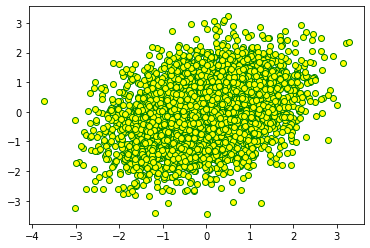

In [93]:
plt.scatter(x_train, y_train, color='yellow', edgecolors='green')

Score TRAIN (R2) - Degree =  2 :  0.109 

Score TEST (R2) - Degree =  2 :  0.126 



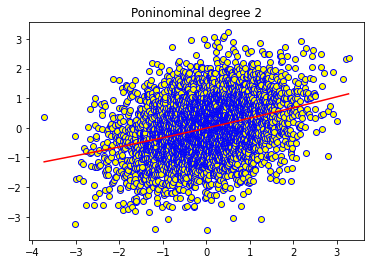



Score TRAIN (R2) - Degree =  3 :  0.11 

Score TEST (R2) - Degree =  3 :  0.127 



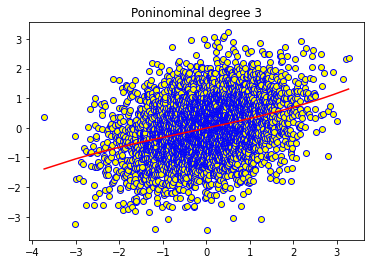



Score TRAIN (R2) - Degree =  4 :  0.11 

Score TEST (R2) - Degree =  4 :  0.127 



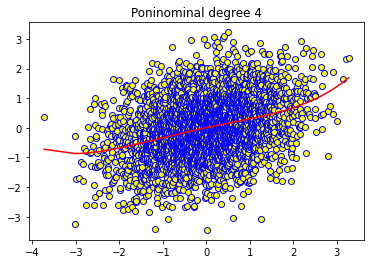



Score TRAIN (R2) - Degree =  5 :  0.11 

Score TEST (R2) - Degree =  5 :  0.127 



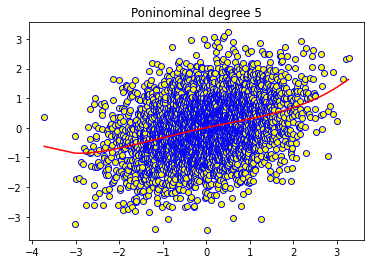



Score TRAIN (R2) - Degree =  6 :  0.11 

Score TEST (R2) - Degree =  6 :  0.127 



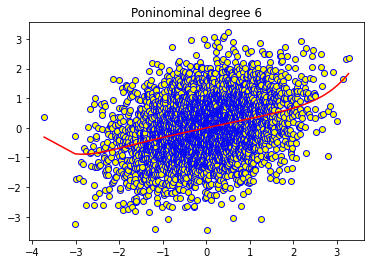



Score TRAIN (R2) - Degree =  7 :  0.11 

Score TEST (R2) - Degree =  7 :  0.126 



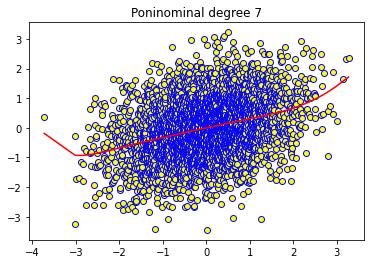



Score TRAIN (R2) - Degree =  8 :  0.111 

Score TEST (R2) - Degree =  8 :  0.103 



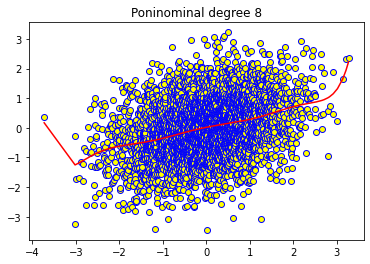



Score TRAIN (R2) - Degree =  9 :  0.112 

Score TEST (R2) - Degree =  9 :  0.128 



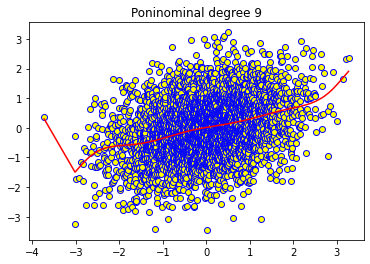



Score TRAIN (R2) - Degree =  10 :  0.112 

Score TEST (R2) - Degree =  10 :  -0.032 



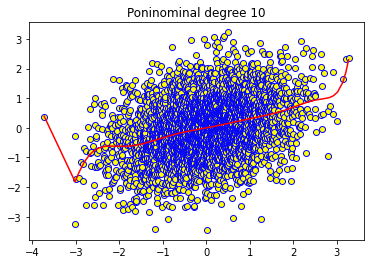



Scores TRAIN:  {'2': 0.109, '3': 0.11, '4': 0.11, '5': 0.11, '6': 0.11, '7': 0.11, '8': 0.111, '9': 0.112, '10': 0.112}
Scores TEST:  {'2': 0.126, '3': 0.127, '4': 0.127, '5': 0.127, '6': 0.127, '7': 0.126, '8': 0.103, '9': 0.128, '10': -0.032}


In [94]:
degree_min = 2
degree_max = 10
scores_train_degree = {}
scores_test_degree = {}
for degree in range(degree_min, degree_max + 1):
    polinomial_model = PolynomialFeatures(degree = degree)
    x_train_poly = polinomial_model.fit_transform(x_train, y_train)

# Entrenar la LinearRegression con la salida del fit_transform (x_train_poly, y_train)
    linreg_model = LinearRegression()
    linreg_model.fit(x_train_poly, y_train)

# Predicción de "y" con "x_poly"
    y_train_pred = linreg_model.predict(x_train_poly)
    #print('y_pred:', y_pred)
    r2_score(y_train, y_train_pred)
    print('Score TRAIN (R2) - Degree = ', degree, ': ', round(r2_score(y_train, y_train_pred),3), '\n')
    scores_train_degree[str(degree)] = round(r2_score(y_train, y_train_pred),3)

# AHORA PARA TEST --> Nótese que, como el modelo polinómico ya está entrenado... No hace falta poner y_train.
    x_test_poly = polinomial_model.fit_transform(x_test) 
    y_test_pred = linreg_model.predict(x_test_poly)
    print('Score TEST (R2) - Degree = ', degree, ': ', round(r2_score(y_test, y_test_pred),3), '\n')
    scores_test_degree[str(degree)] = round(r2_score(y_test, y_test_pred),3)
    


    x_train_to_show, y_train_to_show = zip(*sorted(zip(x_train, y_train)))
    plt.scatter(x_train_to_show, y_train_to_show, color='yellow', edgecolors='blue')
    x_train_to_show, y_train_pred = zip(*sorted(zip(x_train, y_train_pred)))
    plt.plot(x_train_to_show, y_train_pred, color='red')
    #plt.scatter(x_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()
    print('\n===========================================================\n')
print('Scores TRAIN: ', scores_train_degree)
print('Scores TEST: ', scores_test_degree)

## No se observan cambios considerables de score a partir de grado 2.

---

# x --> Bedrooms
# y --> Price

In [95]:
seed = 42
estandarizacion = True

x = np.array(df['Avg. Area Number of Bedrooms']).reshape(-1, 1)
y = np.array(df['Price'])
print('x:', x.shape)
print('y:', y.shape)

if estandarizacion == True:
    st_x = StandardScaler()
    x = st_x.fit_transform(x)
    st_y = StandardScaler()
    y = y.reshape(-1, 1)
    y = st_y.fit_transform(y)

x_train, x_test, y_train, y_test = model_selection.train_test_split(x, y, test_size=0.2, random_state = seed)

x: (5000, 1)
y: (5000,)


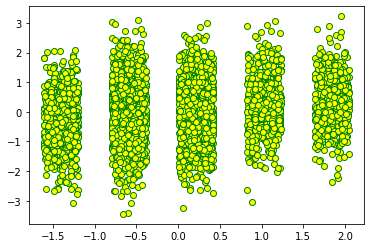

In [96]:
plt.scatter(x_train, y_train, color='yellow', edgecolors='green')

Score TRAIN (R2) - Degree =  2 :  0.031 

Score TEST (R2) - Degree =  2 :  0.02 



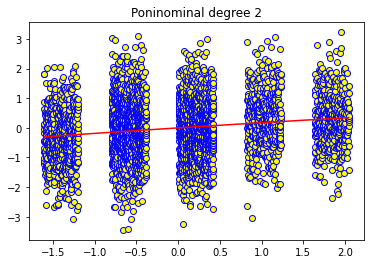



Score TRAIN (R2) - Degree =  3 :  0.031 

Score TEST (R2) - Degree =  3 :  0.019 



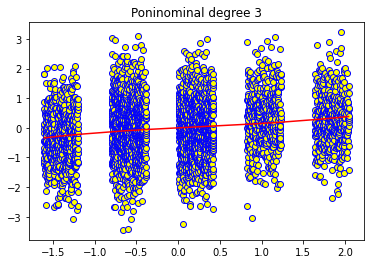



Score TRAIN (R2) - Degree =  4 :  0.036 

Score TEST (R2) - Degree =  4 :  0.021 



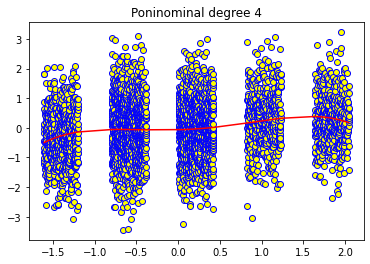



Score TRAIN (R2) - Degree =  5 :  0.037 

Score TEST (R2) - Degree =  5 :  0.021 



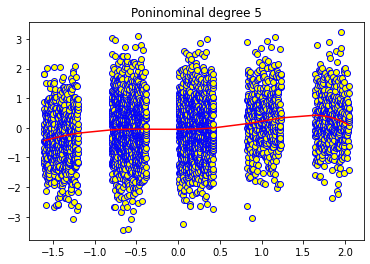



Score TRAIN (R2) - Degree =  6 :  0.039 

Score TEST (R2) - Degree =  6 :  0.019 



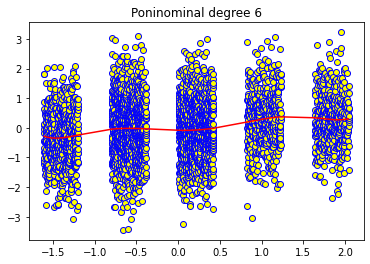



Score TRAIN (R2) - Degree =  7 :  0.039 

Score TEST (R2) - Degree =  7 :  0.018 



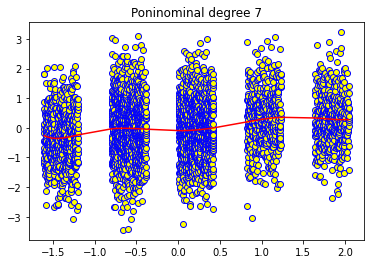



Score TRAIN (R2) - Degree =  8 :  0.039 

Score TEST (R2) - Degree =  8 :  0.018 



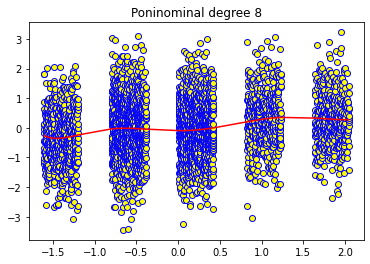



Score TRAIN (R2) - Degree =  9 :  0.039 

Score TEST (R2) - Degree =  9 :  0.018 



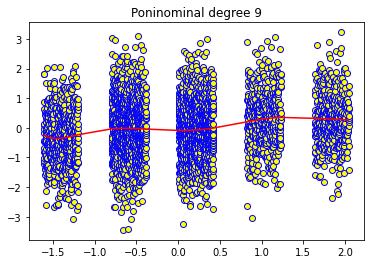



Score TRAIN (R2) - Degree =  10 :  0.04 

Score TEST (R2) - Degree =  10 :  0.017 



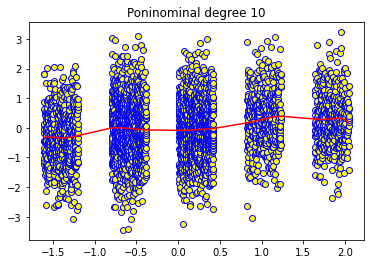



Scores TRAIN:  {'2': 0.031, '3': 0.031, '4': 0.036, '5': 0.037, '6': 0.039, '7': 0.039, '8': 0.039, '9': 0.039, '10': 0.04}
Scores TEST:  {'2': 0.02, '3': 0.019, '4': 0.021, '5': 0.021, '6': 0.019, '7': 0.018, '8': 0.018, '9': 0.018, '10': 0.017}


In [97]:
degree_min = 2
degree_max = 10
scores_train_degree = {}
scores_test_degree = {}
for degree in range(degree_min, degree_max + 1):
    polinomial_model = PolynomialFeatures(degree = degree)
    x_train_poly = polinomial_model.fit_transform(x_train, y_train)

# Entrenar la LinearRegression con la salida del fit_transform (x_train_poly, y_train)
    linreg_model = LinearRegression()
    linreg_model.fit(x_train_poly, y_train)

# Predicción de "y" con "x_poly"
    y_train_pred = linreg_model.predict(x_train_poly)
    #print('y_pred:', y_pred)
    r2_score(y_train, y_train_pred)
    print('Score TRAIN (R2) - Degree = ', degree, ': ', round(r2_score(y_train, y_train_pred),3), '\n')
    scores_train_degree[str(degree)] = round(r2_score(y_train, y_train_pred),3)

# AHORA PARA TEST --> Nótese que, como el modelo polinómico ya está entrenado... No hace falta poner y_train.
    x_test_poly = polinomial_model.fit_transform(x_test) 
    y_test_pred = linreg_model.predict(x_test_poly)
    print('Score TEST (R2) - Degree = ', degree, ': ', round(r2_score(y_test, y_test_pred),3), '\n')
    scores_test_degree[str(degree)] = round(r2_score(y_test, y_test_pred),3)
    


    x_train_to_show, y_train_to_show = zip(*sorted(zip(x_train, y_train)))
    plt.scatter(x_train_to_show, y_train_to_show, color='yellow', edgecolors='blue')
    x_train_to_show, y_train_pred = zip(*sorted(zip(x_train, y_train_pred)))
    plt.plot(x_train_to_show, y_train_pred, color='red')
    #plt.scatter(x_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()
    print('\n===========================================================\n')
print('Scores TRAIN: ', scores_train_degree)
print('Scores TEST: ', scores_test_degree)

## El mejor score se obtiene para grado 5.
---

# x --> Area Population
# y --> Price

In [98]:
seed = 42
estandarizacion = True

x = np.array(df['Area Population']).reshape(-1, 1)
y = np.array(df['Price'])
print('x:', x.shape)
print('y:', y.shape)

if estandarizacion == True:
    st_x = StandardScaler()
    x = st_x.fit_transform(x)
    st_y = StandardScaler()
    y = y.reshape(-1, 1)
    y = st_y.fit_transform(y)

x_train, x_test, y_train, y_test = model_selection.train_test_split(x, y, test_size=0.2, random_state = seed)

x: (5000, 1)
y: (5000,)


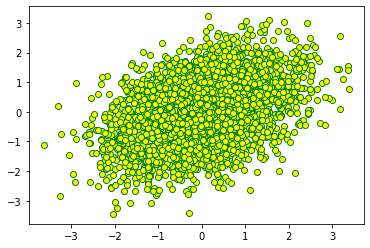

In [99]:
plt.scatter(x_train, y_train, color='yellow', edgecolors='green')

Score TRAIN (R2) - Degree =  2 :  0.165 

Score TEST (R2) - Degree =  2 :  0.171 



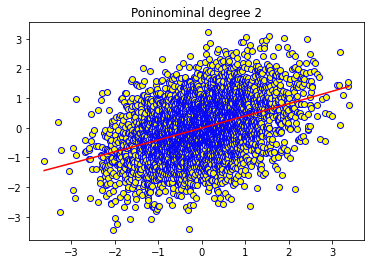



Score TRAIN (R2) - Degree =  3 :  0.166 

Score TEST (R2) - Degree =  3 :  0.171 



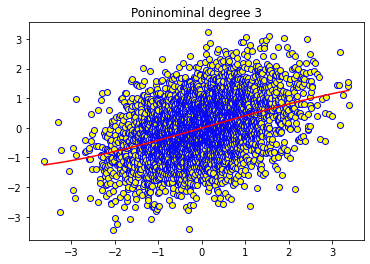



Score TRAIN (R2) - Degree =  4 :  0.166 

Score TEST (R2) - Degree =  4 :  0.171 



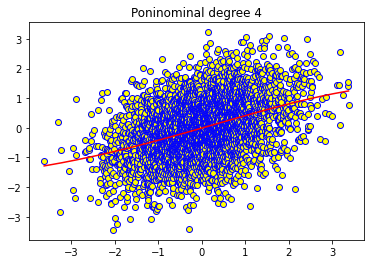



Score TRAIN (R2) - Degree =  5 :  0.166 

Score TEST (R2) - Degree =  5 :  0.171 



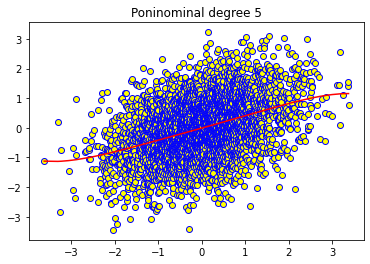



Score TRAIN (R2) - Degree =  6 :  0.166 

Score TEST (R2) - Degree =  6 :  0.171 



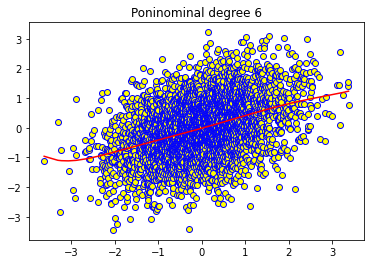



Score TRAIN (R2) - Degree =  7 :  0.166 

Score TEST (R2) - Degree =  7 :  0.171 



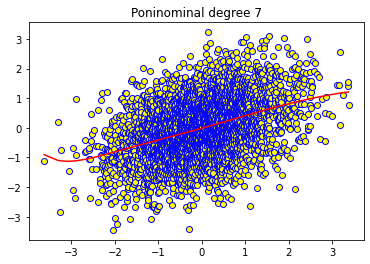



Score TRAIN (R2) - Degree =  8 :  0.166 

Score TEST (R2) - Degree =  8 :  0.172 



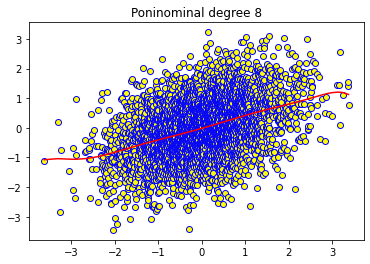



Score TRAIN (R2) - Degree =  9 :  0.166 

Score TEST (R2) - Degree =  9 :  0.172 



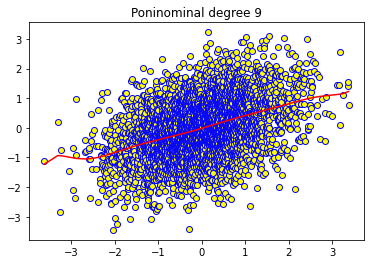



Score TRAIN (R2) - Degree =  10 :  0.166 

Score TEST (R2) - Degree =  10 :  0.172 



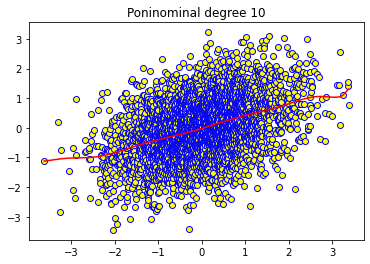



Scores TRAIN:  {'2': 0.165, '3': 0.166, '4': 0.166, '5': 0.166, '6': 0.166, '7': 0.166, '8': 0.166, '9': 0.166, '10': 0.166}
Scores TEST:  {'2': 0.171, '3': 0.171, '4': 0.171, '5': 0.171, '6': 0.171, '7': 0.171, '8': 0.172, '9': 0.172, '10': 0.172}


In [100]:
degree_min = 2
degree_max = 10
scores_train_degree = {}
scores_test_degree = {}
for degree in range(degree_min, degree_max + 1):
    polinomial_model = PolynomialFeatures(degree = degree)
    x_train_poly = polinomial_model.fit_transform(x_train, y_train)

# Entrenar la LinearRegression con la salida del fit_transform (x_train_poly, y_train)
    linreg_model = LinearRegression()
    linreg_model.fit(x_train_poly, y_train)

# Predicción de "y" con "x_poly"
    y_train_pred = linreg_model.predict(x_train_poly)
    #print('y_pred:', y_pred)
    r2_score(y_train, y_train_pred)
    print('Score TRAIN (R2) - Degree = ', degree, ': ', round(r2_score(y_train, y_train_pred),3), '\n')
    scores_train_degree[str(degree)] = round(r2_score(y_train, y_train_pred),3)

# AHORA PARA TEST --> Nótese que, como el modelo polinómico ya está entrenado... No hace falta poner y_train.
    x_test_poly = polinomial_model.fit_transform(x_test) 
    y_test_pred = linreg_model.predict(x_test_poly)
    print('Score TEST (R2) - Degree = ', degree, ': ', round(r2_score(y_test, y_test_pred),3), '\n')
    scores_test_degree[str(degree)] = round(r2_score(y_test, y_test_pred),3)
    


    x_train_to_show, y_train_to_show = zip(*sorted(zip(x_train, y_train)))
    plt.scatter(x_train_to_show, y_train_to_show, color='yellow', edgecolors='blue')
    x_train_to_show, y_train_pred = zip(*sorted(zip(x_train, y_train_pred)))
    plt.plot(x_train_to_show, y_train_pred, color='red')
    #plt.scatter(x_train_to_show, y_pred, color='red')
    plt.title("Poninominal degree " + str(degree))
    plt.show()
    print('\n===========================================================\n')
print('Scores TRAIN: ', scores_train_degree)
print('Scores TEST: ', scores_test_degree)

## No se observan cambios considerables de score a partir de grado 2.